# Manual architecture

In [1]:
# importing the necessary libraries

import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Importing the necessary libraries

import tensorflow as tf
import glob
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dense, MaxPooling2D, Flatten, Convolution2D, Dropout, BatchNormalization
from tensorflow.keras.callbacks import ModelCheckpoint

In [3]:
# Ignoring the warnings

import warnings
warnings.filterwarnings('ignore')

In [4]:
# Saving the folder path of the images individually

dir_name_train_calling='dataset/train/calling'
dir_name_train_cycling='dataset/train/cycling'
dir_name_train_dancing='dataset/train/dancing'
dir_name_train_fighting='dataset/train/fighting'
dir_name_train_hugging='dataset/train/hugging'
dir_name_train_laughing='dataset/train/laughing'

In [5]:
def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0
    
    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])
        
    image_details_print(data,path)

In [6]:
def plot_images(path, n=6):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    
    plt.figure(figsize=(80,40))
    for idx, img_path in enumerate(files[:n]):
        plt.subplot(7, n, idx+1)
        img=plt.imread(img_path)
        plt.imshow(img)
        plt.axis('off')
        
    plt.tight_layout()


Trained data for calling

======== Images in:  dataset/train/calling
Images_count :	 297
Min_width :	 134
Max_width :	 357
Min_height :	 135
Max_height :	 291



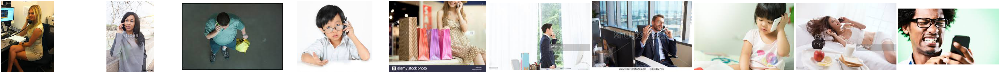

In [7]:
# Printing min and maximum size along with some image of calling

print("")
print('Trained data for calling')
print("")
images_details(dir_name_train_calling)
print("")
plot_images(dir_name_train_calling,10)


Trained data for cycling

======== Images in:  dataset/train/cycling
Images_count :	 308
Min_width :	 177
Max_width :	 414
Min_height :	 121
Max_height :	 285



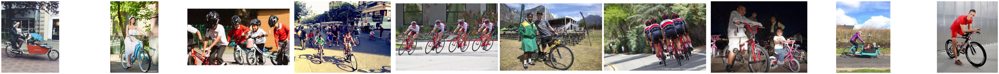

In [8]:
# Printing min and maximum size along with some image of cycling

print("")
print('Trained data for cycling')
print("")
images_details(dir_name_train_cycling)
print("")
plot_images(dir_name_train_cycling,10)


Trained data for dancing

======== Images in:  dataset/train/dancing
Images_count :	 297
Min_width :	 96
Max_width :	 331
Min_height :	 135
Max_height :	 303



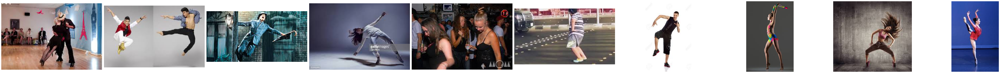

In [9]:
# Printing min and maximum size along with some image of dancing

print("")
print('Trained data for dancing')
print("")
images_details(dir_name_train_dancing)
print("")
plot_images(dir_name_train_dancing,10)


Trained data for fighting

======== Images in:  dataset/train/fighting
Images_count :	 297
Min_width :	 154
Max_width :	 346
Min_height :	 104
Max_height :	 300



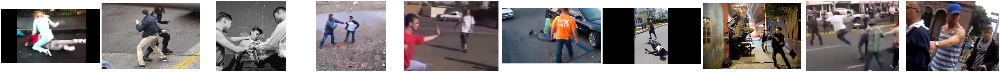

In [10]:
# Printing min and maximum size along with some image of fighting

print("")
print('Trained data for fighting')
print("")
images_details(dir_name_train_fighting)
print("")
plot_images(dir_name_train_fighting,10)


Trained data for hugging

======== Images in:  dataset/train/hugging
Images_count :	 297
Min_width :	 125
Max_width :	 318
Min_height :	 130
Max_height :	 290



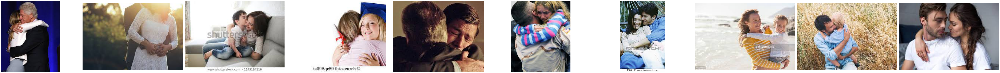

In [11]:
# Printing min and maximum size along with some image of hugging

print("")
print('Trained data for hugging')
print("")
images_details(dir_name_train_hugging)
print("")
plot_images(dir_name_train_hugging,10)


Trained data for laughing

======== Images in:  dataset/train/laughing
Images_count :	 297
Min_width :	 162
Max_width :	 390
Min_height :	 129
Max_height :	 310



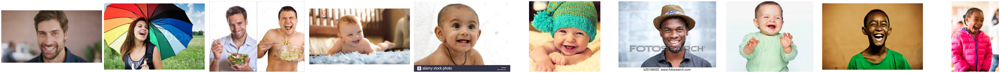

In [14]:
# Printing min and maximum size along with some image of laughing

print("")
print('Trained data for laughing')
print("")
images_details(dir_name_train_laughing)
print("")
plot_images(dir_name_train_laughing,10)

In [15]:
### Data augmentation

train_datagen=ImageDataGenerator(rescale=1./255, shear_range=0.2, zoom_range=0.2)
test_datagen=ImageDataGenerator(rescale=1./255)

In [16]:
# having train and test images

training_set=train_datagen.flow_from_directory('dataset/train', batch_size=100, class_mode='categorical', target_size=(255,255))
testing_set=test_datagen.flow_from_directory('dataset/test', batch_size=100, class_mode='categorical', target_size=(255,255))

Found 4420 images belonging to 15 classes.
Found 825 images belonging to 15 classes.


In [17]:
## Creating cnn layer

# initialized the model
model=Sequential()  

# Adding first convolution layer
model.add(Convolution2D(32,(3,3),input_shape=(255,255,3), padding='same', activation='relu'))

# Adding first Maxpool layer
model.add(MaxPooling2D(pool_size=(2,2)))

# Adding Flatten layer
model.add(Flatten())

# Adding input layer
model.add(Dense(units=164, activation='relu', ))

# Adding dropout layer
model.add(Dropout(0.2))

# Adding Hidden layer
model.add(Dense(units=122, activation='relu'))
model.add(Dropout(0.2))

# Adding output layer
model.add(Dense(units=15, activation='softmax'))


model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 255, 255, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 32)     0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 516128)            0         
                                                                 
 dense (Dense)               (None, 164)               84645156  
                                                                 
 dropout (Dropout)           (None, 164)               0         
                                                                 
 dense_1 (Dense)             (None, 122)               20130     
                                                        

In [18]:
# Compilin the model

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

mc = ModelCheckpoint('Manual.h5', monitor = 'val_loss',  save_best_only = True)

In [19]:
# Fitting the model

history=model.fit(training_set, 
          steps_per_epoch= training_set.samples//100, 
          validation_data=testing_set, 
          validation_steps= testing_set.samples//100, 
          epochs=10, callbacks=[mc])

Epoch 1/10
44/44 [==============================] - 135s 3s/step - loss: 8.6059 - accuracy: 0.0694 - val_loss: 2.7083 - val_accuracy: 0.0650
Epoch 2/10
44/44 [==============================] - 133s 3s/step - loss: 2.7079 - accuracy: 0.0664 - val_loss: 2.7080 - val_accuracy: 0.0662
Epoch 3/10
44/44 [==============================] - 129s 3s/step - loss: 2.7072 - accuracy: 0.0675 - val_loss: 2.7090 - val_accuracy: 0.0688
Epoch 4/10
44/44 [==============================] - 128s 3s/step - loss: 2.7076 - accuracy: 0.0609 - val_loss: 2.7086 - val_accuracy: 0.0650
Epoch 5/10
44/44 [==============================] - 128s 3s/step - loss: 2.7073 - accuracy: 0.0648 - val_loss: 2.7104 - val_accuracy: 0.0675
Epoch 6/10
44/44 [==============================] - 127s 3s/step - loss: 2.7138 - accuracy: 0.0681 - val_loss: 2.7089 - val_accuracy: 0.0675
Epoch 7/10
44/44 [==============================] - 128s 3s/step - loss: 2.7074 - accuracy: 0.0681 - val_loss: 2.7089 - val_accuracy: 0.0675
Epoch 8/10
44

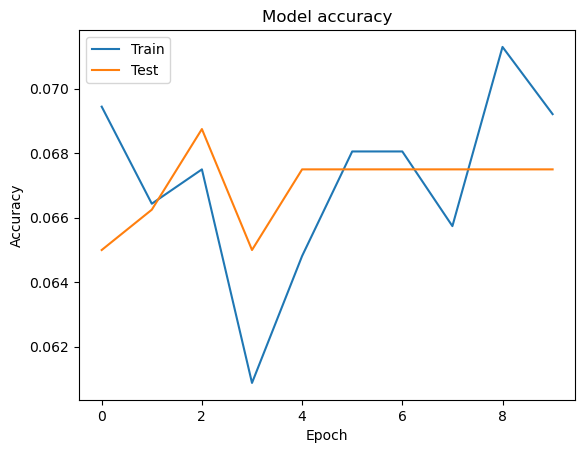

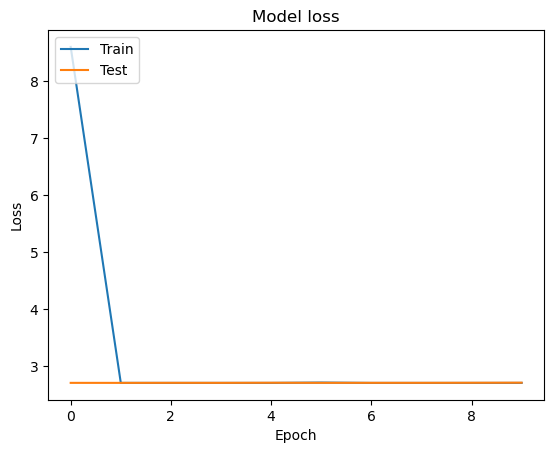

In [20]:
def plot():
    # Plot training & validation accuracy values
    
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
plot()